In [1]:
#Project Instructions
#1. Select a sleep apnea database (e.g. apnea-ecg database from Physionet) and read the dataset descriptions to identify the healthy and apnea subjects.</br>
#2. Download all the records, and process the records to extract HRV features using a software (e.g. HRVanalysis) or in python.</br>
#3. Visualize/compare the features using descriptive statistics between healthy and apneic subjects.</br>
#4. Use inferential statistics (e.g. t-test, Mann-Whitney U test) to find if there is any significant difference between the groups. </br>

In [2]:
#1. Select a sleep apnea database (e.g. apnea-ecg database from Physionet) and 
#read the dataset descriptions to identify the healthy and apnea subjects.</br>

In [3]:
# The data consist of 70 records, 
# divided into a learning set of 35 records (a01 through a20, b01 through b05, and c01 through c10), 
# and a test set of 35 records (x01 through x35). 
# Recordings vary in length from slightly less than 7 hours to nearly 10 hours each. 
#
# Each recording includes 
# 1. a continuous digitized ECG signal, 
# 2. a set of apnea annotations (derived by human experts on the basis of simultaneously recorded respiration and related signals), 
# 3. and a set of machine-generated QRS annotations (in which all beats regardless of type have been labeled normal). 
# 
# In addition, eight recordings (a01 through a04, b01, and c01 through c03) are accompanied by four additional signals 
# (Resp C and Resp A, chest and abdominal respiratory effort signals obtained using inductance plethysmography; 
# Resp N, oronasal airflow measured using nasal thermistors; and SpO2, oxygen saturation).

# Several files are associated with each recording. 
# 1. The files with names of the form rnn.dat contain the digitized ECGs 
#    (16 bits per sample, least significant byte first in each pair, 100 samples per second, nominally 200 A/D units per millivolt). 
# 2. The .hea files are (text) header files that specify the names and formats of the associated signal files;
#.   these header files are needed by the software available from this site. 
# 3. The .apn files are (binary) annotation files, 
#    containing an annotation for each minute of each recording indicating the presence or absence of apnea at that time; 
#    these are available for the 35 learning set recordings only. 
# 4. The qrs files are machine-generated (binary) annotation files, made using sqrs125, 
#.   and provided for the convenience of those who do not wish to use their own QRS detectors. 
#.   Please note that the .qrs files are unaudited and contain errors. 

# In April 2013, Chiu-wen Wu reported that training set control records c05 and c06 come from the same original recording 
# (c05 begins 80 seconds later than c06). 
# The slightly different descriptions of these records in additional-information.txt suggest that 
# c06 may have been a corrected version of c05.

In [4]:
#2. Download all the records, 
# and process the records to extract HRV features using a software (e.g. HRVanalysis) or in python.</br>

In [5]:
from IPython.display import display
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import os
import shutil
import posixpath
import wfdb

In [6]:
# List the PhysioNet Databases

dbs = wfdb.get_dbs()
display(dbs)

[['aami-ec13', 'ANSI/AAMI EC13 Test Waveforms'],
 ['accelerometry-walk-climb-drive',
  'Labeled raw accelerometry data captured during walking, stair climbing and driving'],
 ['adfecgdb', 'Abdominal and Direct Fetal ECG Database'],
 ['afdb', 'MIT-BIH Atrial Fibrillation Database'],
 ['afpdb', 'PAF Prediction Challenge Database'],
 ['aftdb', 'AF Termination Challenge Database'],
 ['ahadb', 'AHA Database Sample Excluded Record'],
 ['antimicrobial-resistance-uti',
  'AMR-UTI: Antimicrobial Resistance in Urinary Tract Infections'],
 ['apnea-ecg', 'Apnea-ECG Database'],
 ['autonomic-aging-cardiovascular',
  'Autonomic Aging: A dataset to quantify changes of cardiovascular autonomic function during healthy aging'],
 ['bhx-brain-bounding-box',
  'Brain Hemorrhage Extended (BHX): Bounding box extrapolation from thick to thin slice CT images'],
 ['bidmc', 'BIDMC PPG and Respiration Dataset'],
 ['bigideaslab-step-hr-smartwatch',
  'BigIdeasLab_STEP: Heart rate measurements captured by smartwatch

In [ ]:
# Download all the WFDB records and annotations from a small PhysioNet Database

# Make a temporary download directory in your current working directory
cwd = os.getcwd()
dl_dir = os.path.join(cwd, 'apnea-db')

#Download apnea-ecg database using the WFDB download function
wfdb.dl_database('apnea-ecg', dl_dir=dl_dir)

# Display the downloaded content in the folder
#display(os.listdir(dl_dir))

# Cleanup: delete the downloaded directory
# shutil.rmtree(dl_dir)

In [7]:
#!pip install biosppy

In [8]:
import biosppy
from hrvanalysis import remove_ectopic_beats, interpolate_nan_values, get_time_domain_features, get_frequency_domain_features, get_geometrical_features
from hrvanalysis import get_csi_cvi_features, get_poincare_plot_features
from hrvanalysis.extract_features import get_frequency_domain_features
import csv
import pandas as pd

In [ ]:
cwd = os.getcwd()
dl_dir = os.path.join(cwd, 'apnea-db')

In [ ]:
# Find the list of records to consider
rec_list = list(set([os.path.splitext(x)[0] for x in os.listdir(dl_dir)]))
# Remove records of the form '...er', which are recordings with the four additional 
# signals that we will not consider here.
rec_list = [record for record in rec_list if record[-1]!='r']

In [ ]:
rec_list

In [ ]:
def get_record_features(record,rec_name):
    
    # Get nn_interval   
    ind= biosppy.signals.ecg.ecg(record.p_signal[:,0], sampling_rate=100, show=False)
    # Find index differences between successive R peaks.
    rr_ind = np.diff(ind['rpeaks'])
    rr_ms = [element * 10 for element in rr_ind] 
    # Remove ectopic beats
    ect_ind = remove_ectopic_beats(rr_ms)
    nn_interval = interpolate_nan_values(rr_intervals=ect_ind)
    
    # Instantiate results dictionary with time and freq features
    results = {}
    
    # Populate results dictionary with time features
    
    time_dict = get_time_domain_features(nn_interval)
    results['avnn'] = time_dict['mean_nni']
    results['hr'] = time_dict['mean_hr']
    results['SDNN'] = time_dict['sdnn']
    results['pNN50'] = time_dict['pnni_20']
    results['RMSSD'] = time_dict['rmssd']
    results['HRdiff'] = time_dict['max_hr'] - time_dict['min_hr']
    
    # Populate results dictionary with freq features
    freq_dict = get_frequency_domain_features(nn_interval)
    results['VLF'] = freq_dict['vlf']
    results['LF'] = freq_dict['lf']
    results['HF'] = freq_dict['hf']
    results['LHFratio'] = freq_dict['lf_hf_ratio']
    
    # Add summary information from record_info.csv (AI, HI, H-healthy, A-Apnea, Age, Sex, Height and Weight)
    # Where is this file?
    
    # Add the name of the record
    results['record']=rec_name
    print("within function", results)
    return results

In [ ]:
# Define variables for writing to features.csv
csv_file = "features_vikram.csv"
write_column = True
with open(csv_file, 'w') as csvfile:

# Iterate through list of records, load the ECG record and run get_record_features
# and write to features.csv
    for rec_name in rec_list:
        record = wfdb.rdrecord('apnea-db/'+rec_name)
        #, sampfrom=0,sampto=10000)
        results = get_record_features(record,rec_name)

        if write_column:
            csv_columns = results.keys()
            writer = csv.DictWriter(csvfile, fieldnames=csv_columns)
            writer.writeheader()
            write_column = False
            print("printed first record")

        writer.writerow(results)
        print("writing record", results)

In [ ]:
# Merge features received from WFDB functions for each record with static information of each record. 
# This will give the dataset for Exploratory Data Analytics

# Start by looking at the additional information on:
# https://physionet.org/content/apnea-ecg/1.0.0/additional-information.txt
# to determine those patients that have sleep apnea and those that do not.
# Note that this cell requires record_info.csv file, which is the tabulated data
# from the linked .txt file 

In [9]:
record_annot = pd.read_csv('ecg_annotations.csv')

In [10]:
features = pd.read_csv('features_vikram.csv')

In [11]:
record_features_annot = pd.merge(record_annot, features, how = 'left', left_on=['Record'], right_on=['record'])

In [12]:
#add Target Variable - have apnea or not - 
# Add a new column with value A is hours w/apnea > 0 and H otherwise
record_features_annot['class_A_or_H'] = np.where(record_features_annot['hours w/apnea']>0, 'A','H')

In [13]:
record_features_annot

,Record,Length minutes,non-apn minutes,apnea minutes,hours w/apnea,AI,HI,AHI,Age,Sex,...,SDNN,pNN50,RMSSD,HRdiff,VLF,LF,HF,LHFratio,record,class_A_or_H
0,a01,490,20,470,9,12.50,57.1,69.60,51,M,...,157.706006,64.956408,65.864812,74.003190,1.036235e+04,5.701578e+03,790.855953,7.209377,a01,A
1,a02,529,109,420,9,57.20,12.3,69.50,38,M,...,64.193944,14.896261,26.544540,5962.962963,1.117474e+03,8.893835e+02,170.088310,5.228951,a02,A
2,a03,520,274,246,9,38.40,0.7,39.10,54,M,...,5758.374538,34.604327,4696.214855,272.657110,2.530650e+07,3.885819e+06,331333.108117,11.727830,a03,A
3,a04,493,40,453,9,73.40,4.0,77.40,52,M,...,116.699094,34.504516,35.982731,329.131653,5.181498e+03,1.692757e+03,218.473274,7.748121,a04,A
4,a05,455,179,276,8,35.00,6.0,41.00,58,M,...,84.427950,36.733771,31.405566,131.694469,2.583240e+03,1.045707e+03,275.291663,3.798541,a05,A
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,x31,558,42,516,10,86.80,6.7,93.50,29,F,...,170.652979,69.050266,77.428035,816.046967,1.187010e+04,8.890147e+03,1047.436477,8.487529,x31,A
66,x32,539,114,425,9,63.30,8.5,71.80,29,F,...,160.200333,66.995810,74.891299,455.223881,9.047280e+03,5.925018e+03,1233.981643,4.801545,x32,A
67,x33,474,471,3,0,0.13,0.0,0.13,28,F,...,76.938964,29.079755,30.307341,391.986063,1.033221e+03,9.752120e+02,336.436332,2.898652,x33,H
68,x34,476,472,4,0,0.38,0.0,0.38,30,F,...,77.158760,29.120847,30.484251,391.986063,1.061486e+03,9.964393e+02,338.924272,2.940006,x34,H


In [14]:
record_features_annot.to_csv('record_features_annot.csv')

In [15]:
#3. Visualize/compare the features using descriptive statistics between healthy and apneic subjects.</br>

In [16]:
# Descriptive statistics based on each group - 
record_features_annot.groupby('class_A_or_H').describe()

Length minutes                                                  \
                      count    mean        std    min     25%    50%    75%   
class_A_or_H                                                                  
A                      50.0  501.26  27.935648  430.0  490.00  508.0  515.5   
H                      20.0  468.25  28.089846  401.0  454.75  470.0  483.0   

                    non-apn minutes          ...            HF                 \
                max           count    mean  ...           75%            max   
class_A_or_H                                 ...                                
A             578.0            50.0  240.44  ...   1061.065165  331333.108117   
H             535.0            20.0  467.00  ...  14045.070411  181460.184114   

             LHFratio                                                   \
                count     mean       std       min       25%       50%   
class_A_or_H                                                             
A                50.0  6.24428  3.394027  1.663455  4.204995  5.460540   
H                20.0  8.59242  8.448108  1.744754  3.395912  5.437061   

                                   
                   75%        max  
class_A_or_H                       
A             7.702843  16.787031  
H             9.305703  33.966899  

[2 rows x 160 columns]

In [17]:
#Autoviz report w.r.t Target variable

In [18]:
#!pip install autoviz

In [19]:
#!pip install dask

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
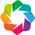

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
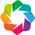

Imported AutoViz_Class version: 0.1.00. Call using:
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Note: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.


In [20]:
#importing Autoviz class
from autoviz.AutoViz_Class import AutoViz_Class#Instantiate the AutoViz class
AV = AutoViz_Class()

Shape of your Data Set loaded: (70, 25)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    24 Predictors classified...
        This does not include the Target column(s)
        2 variables removed since they were ID or low-information variables

################ Binary_Classification VISUALIZATION Started #####################


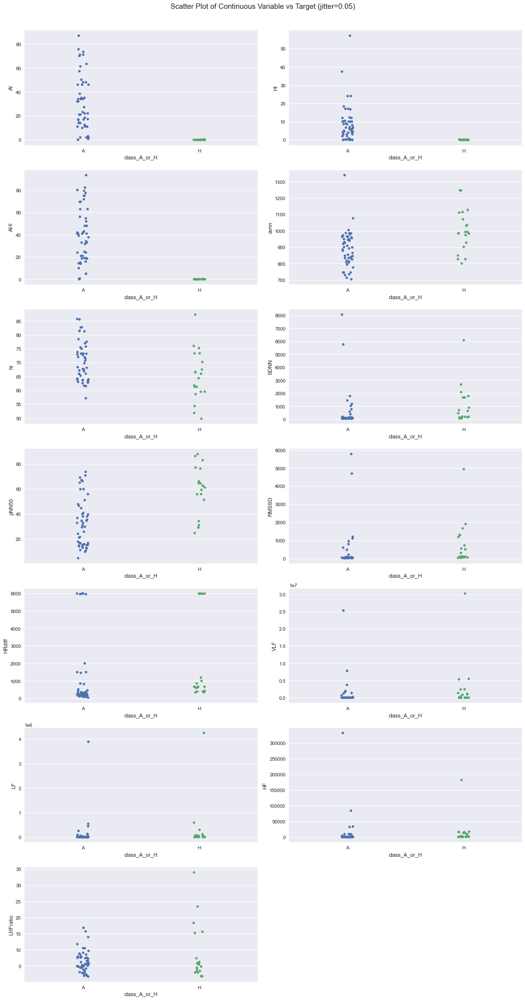

Total Number of Scatter Plots = 91


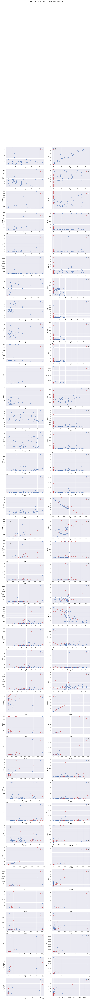

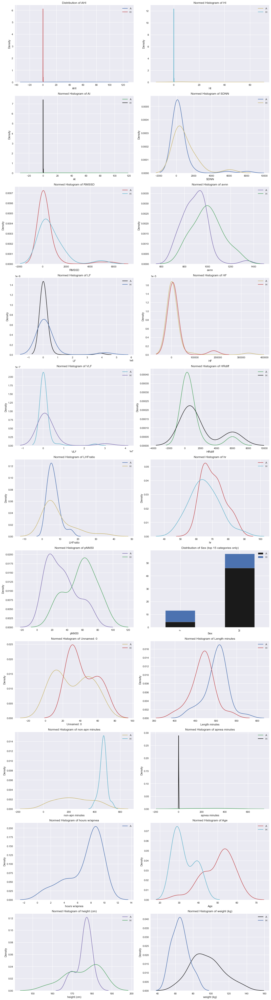

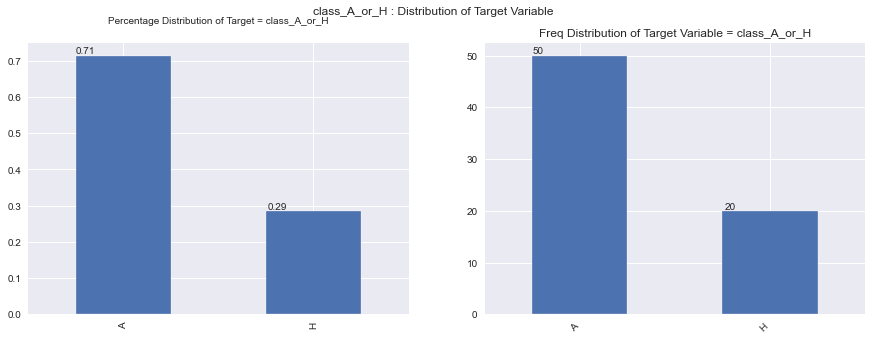

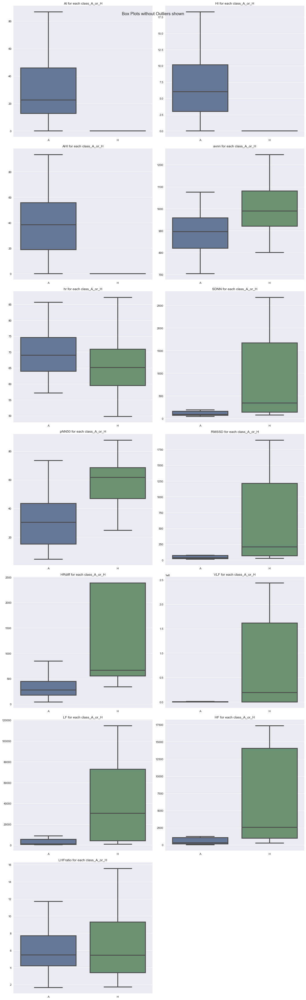

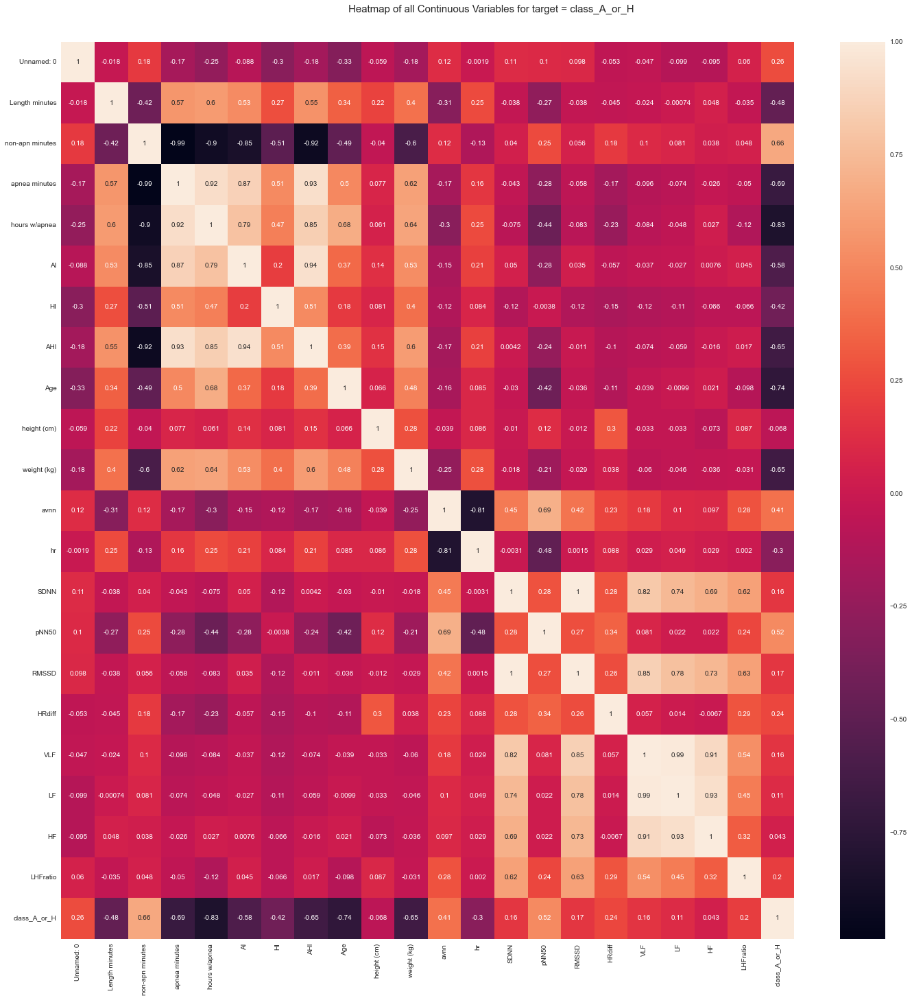

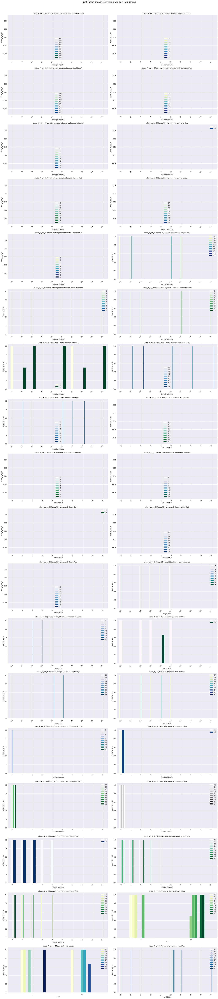

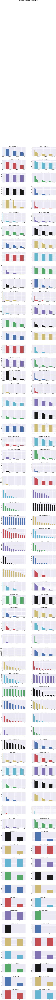

Time to run AutoViz (in seconds) = 66

 ###################### VISUALIZATION Completed ########################


,Unnamed: 0,Length minutes,non-apn minutes,apnea minutes,hours w/apnea,AI,HI,AHI,Age,Sex,...,hr,SDNN,pNN50,RMSSD,HRdiff,VLF,LF,HF,LHFratio,class_A_or_H
0,0,490,20,470,9,12.50,57.1,69.60,51,M,...,62.539278,157.706006,64.956408,65.864812,74.003190,1.036235e+04,5.701578e+03,790.855953,7.209377,0
1,1,529,109,420,9,57.20,12.3,69.50,38,M,...,81.462452,64.193944,14.896261,26.544540,5962.962963,1.117474e+03,8.893835e+02,170.088310,5.228951,0
2,2,520,274,246,9,38.40,0.7,39.10,54,M,...,67.091411,5758.374538,34.604327,4696.214855,272.657110,2.530650e+07,3.885819e+06,331333.108117,11.727830,0
3,3,493,40,453,9,73.40,4.0,77.40,52,M,...,63.827720,116.699094,34.504516,35.982731,329.131653,5.181498e+03,1.692757e+03,218.473274,7.748121,0
4,4,455,179,276,8,35.00,6.0,41.00,58,M,...,64.003389,84.427950,36.733771,31.405566,131.694469,2.583240e+03,1.045707e+03,275.291663,3.798541,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,65,558,42,516,10,86.80,6.7,93.50,29,F,...,63.914802,170.652979,69.050266,77.428035,816.046967,1.187010e+04,8.890147e+03,1047.436477,8.487529,0
66,66,539,114,425,9,63.30,8.5,71.80,29,F,...,65.980089,160.200333,66.995810,74.891299,455.223881,9.047280e+03,5.925018e+03,1233.981643,4.801545,0
67,67,474,471,3,0,0.13,0.0,0.13,28,F,...,73.281793,76.938964,29.079755,30.307341,391.986063,1.033221e+03,9.752120e+02,336.436332,2.898652,1
68,68,476,472,4,0,0.38,0.0,0.38,30,F,...,73.317079,77.158760,29.120847,30.484251,391.986063,1.061486e+03,9.964393e+02,338.924272,2.940006,1


In [21]:
AV.AutoViz('record_features_annot.csv', depVar='class_A_or_H')

In [22]:
#4. Use inferential statistics (e.g. t-test, Mann-Whitney U test) to find if there is any significant difference between the groups. </br>

In [23]:
from scipy.stats import ttest_ind
from scipy.stats import mannwhitneyu

In [24]:
# Split into healthy and apnea records
apnea_records = record_features_annot[record_features_annot['class_A_or_H']=='A']
healthy_records = record_features_annot[record_features_annot['class_A_or_H']=='H']

In [25]:
# Loop over all columns in the record_features_annot. 
# If the column is numeric, print results of t-test for this column

In [26]:
for column in record_features_annot.columns:
    column_type = str(type(record_features_annot[column][0]))
    print(column, column_type)
    
    if column_type.find("str") == -1:
        print("Numeric Variable")
        print(ttest_ind(apnea_records[column], healthy_records[column]), '\n')
    else:
        print("String Variable", '\n')

Record <class 'str'>
String Variable 

Length minutes <class 'numpy.int64'>
Numeric Variable
Ttest_indResult(statistic=4.459304603236931, pvalue=3.160584407864311e-05) 

non-apn minutes <class 'numpy.int64'>
Numeric Variable
Ttest_indResult(statistic=-7.213605011995075, pvalue=5.841468378687266e-10) 

apnea minutes <class 'numpy.int64'>
Numeric Variable
Ttest_indResult(statistic=7.765724955687313, pvalue=5.836331509322218e-11) 

hours w/apnea <class 'numpy.int64'>
Numeric Variable
Ttest_indResult(statistic=12.304295407514022, pvalue=5.827064626875878e-19) 

AI <class 'numpy.float64'>
Numeric Variable
Ttest_indResult(statistic=5.826512202606687, pvalue=1.7045003168229065e-07) 

HI <class 'numpy.float64'>
Numeric Variable
Ttest_indResult(statistic=3.789719342146594, pvalue=0.0003223277432688157) 

AHI <class 'numpy.float64'>
Numeric Variable
Ttest_indResult(statistic=7.0146407959518795, pvalue=1.3349643668792719e-09) 

Age <class 'numpy.int64'>
Numeric Variable
Ttest_indResult(statistic=

In [27]:
# Loop over all columns in the record_features_annot. 
# If the column is numeric, print results of mannwhitneyu-test for this column

In [28]:
for column in record_features_annot.columns:
    column_type = str(type(record_features_annot[column][0]))
    print(column, column_type)
    
    if column_type.find("str") == -1:
        print("Numeric Variable")
        print(mannwhitneyu(apnea_records[column], healthy_records[column]), '\n')
    else:
        print("String Variable", '\n')

Record <class 'str'>
String Variable 

Length minutes <class 'numpy.int64'>
Numeric Variable
MannwhitneyuResult(statistic=826.5, pvalue=2.229713037587413e-05) 

non-apn minutes <class 'numpy.int64'>
Numeric Variable
MannwhitneyuResult(statistic=38.5, pvalue=2.0515848494415612e-09) 

apnea minutes <class 'numpy.int64'>
Numeric Variable
MannwhitneyuResult(statistic=1000.0, pvalue=8.02743676186212e-11) 

hours w/apnea <class 'numpy.int64'>
Numeric Variable
MannwhitneyuResult(statistic=1000.0, pvalue=2.5210571317066852e-11) 

AI <class 'numpy.float64'>
Numeric Variable
MannwhitneyuResult(statistic=996.5, pvalue=7.774043375917395e-11) 

HI <class 'numpy.float64'>
Numeric Variable
MannwhitneyuResult(statistic=935.0, pvalue=7.326770774081909e-09) 

AHI <class 'numpy.float64'>
Numeric Variable
MannwhitneyuResult(statistic=995.5, pvalue=8.996876598283414e-11) 

Age <class 'numpy.int64'>
Numeric Variable
MannwhitneyuResult(statistic=953.5, pvalue=3.6753597285234498e-09) 

Sex <class 'str'>
Strin